# Import Packages

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os

# Camera Calibration

## Read in and make a list of calibration images

In [2]:
images = glob.glob('./camera_cal/calibration*.jpg')

## Arrays to store object and image points from all imaes

In [3]:
objpoints = []
imgpoints = []

## Define chessboard size

In [4]:
nx = 9
ny = 6
objp = np.zeros((ny*nx, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)

## Iterate through each calibration image

In [5]:
for fname in images:
    #read each image
    img = mpimg.imread(fname)

    #Conver image to gray scale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    #Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)


    #If corners are found, add object points and image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)

        #draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)

## Undistorting images

In [6]:
def undistorting(img, objpoints, imgpoints):
    # Camera calibration, given object points, image points and the shape of the grayscale image
    imgSize = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, imgSize, None, None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst

### Display original image and undistorted image

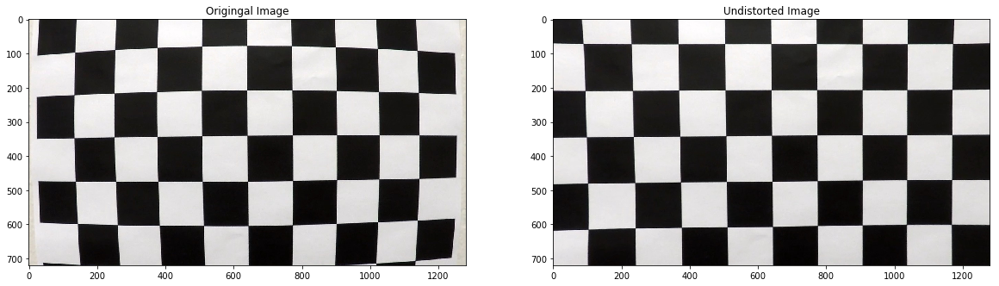

In [7]:
# Read image, plot original and undistorted image
imageCal = os.path.basename('./camera_cal/calibration1.jpg')
imgCal = mpimg.imread('./camera_cal/calibration1.jpg')

# use function undistorting for read image
undistCal = undistorting(imgCal, objpoints, imgpoints)

# plot original and undistorted image
f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
ax1.set_title('Origingal Image')
ax1.imshow(imgCal)
ax2.set_title('Undistorted Image')
ax2.imshow(undistCal)
plt.savefig('{}/{}'.format('./output_images/', imageCal[0:12] + '_chessboardUndist.png'))
plt.show()

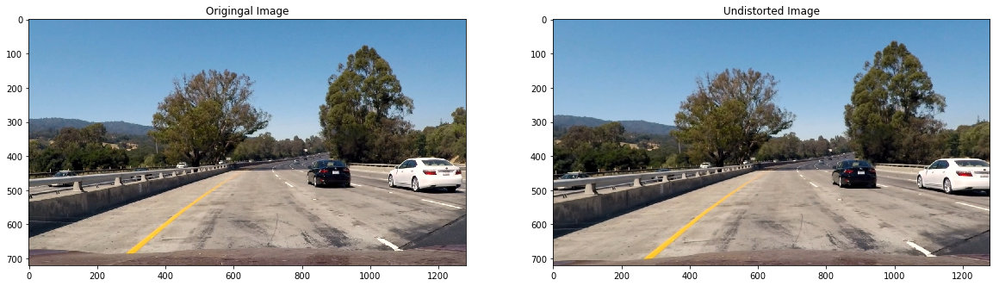

In [8]:
# Read image, plot original and undistorted image
imgCal = mpimg.imread('./test_images/test1.jpg')

# use function undistorting for read image
undistCal = undistorting(imgCal, objpoints, imgpoints)

# plot original and undistorted image
f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
ax1.set_title('Origingal Image')
ax1.imshow(imgCal)
ax2.set_title('Undistorted Image')
ax2.imshow(undistCal)
plt.savefig('{}'.format('./output_images/test1_undistorted.jpg'))
plt.show()

# Methods (Sobel, Mag. of grad., Direction of grad., HLS and Color Thresholds, Transformation)

## Sobel

In [9]:
def abs_sobel_thresh(img, orient='x', thresh=(20, 100)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return binary_output

### Sobel test image

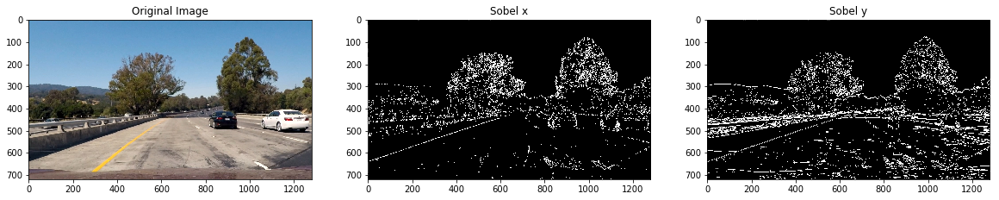

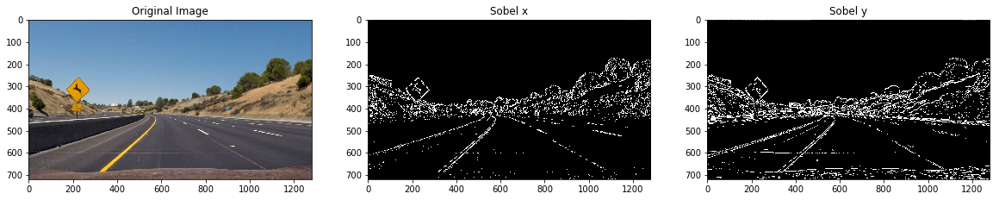

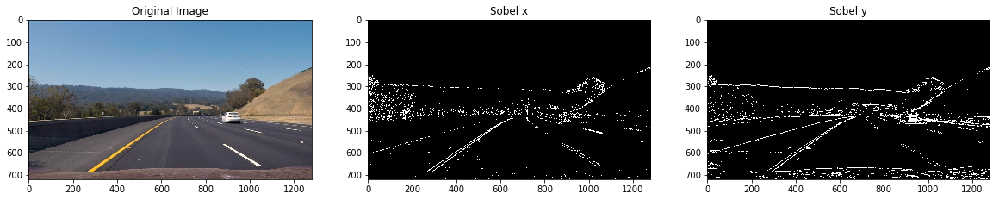

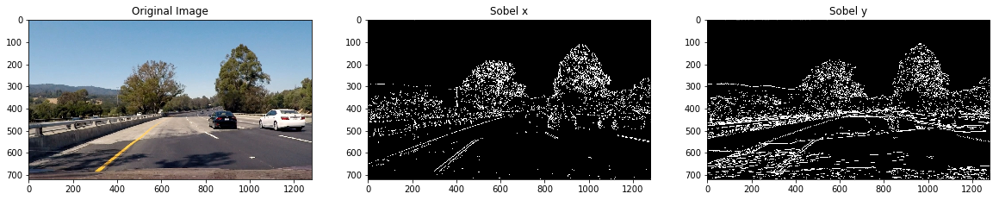

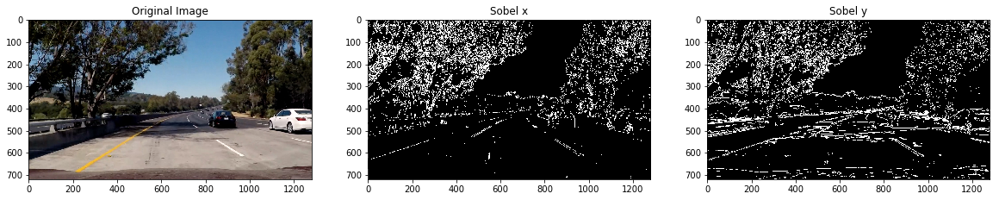

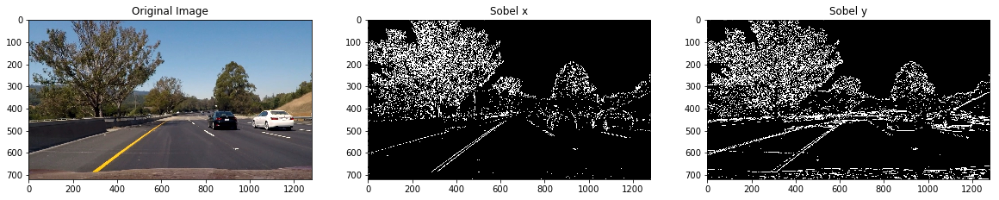

In [10]:
#imageName = os.path.basename('./test_images/straight_lines1.jpg')
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate sobel in x and y direction
    xsobel = abs_sobel_thresh(image,'x', (20, 100))
    ysobel = abs_sobel_thresh(image,'y', (20, 100))
    # plot original, sobel x and y
    f, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Sobel x')
    ax2.imshow(xsobel, cmap='gray')
    ax3.set_title('Sobel y')
    ax3.imshow(ysobel, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_sobel.png'))
    plt.show()

## Magnitude of the gradient

In [11]:
# Magnitude of the gradient
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

### Magnitude test images

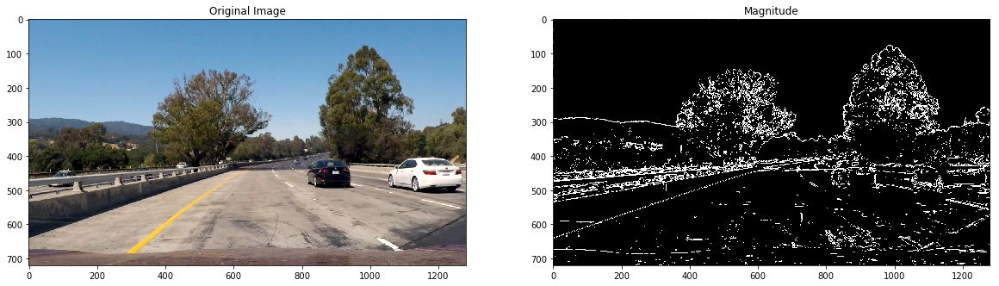

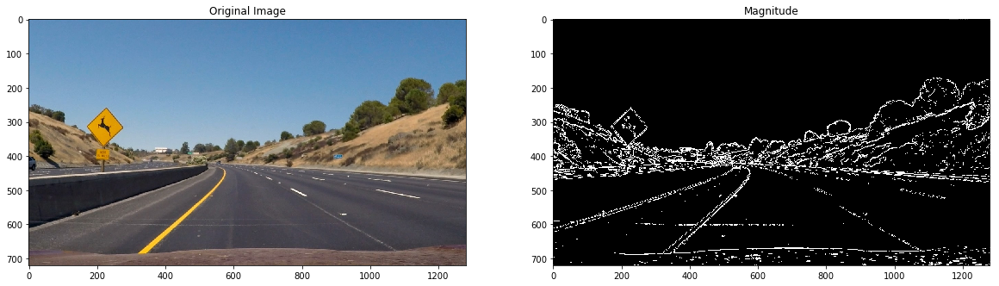

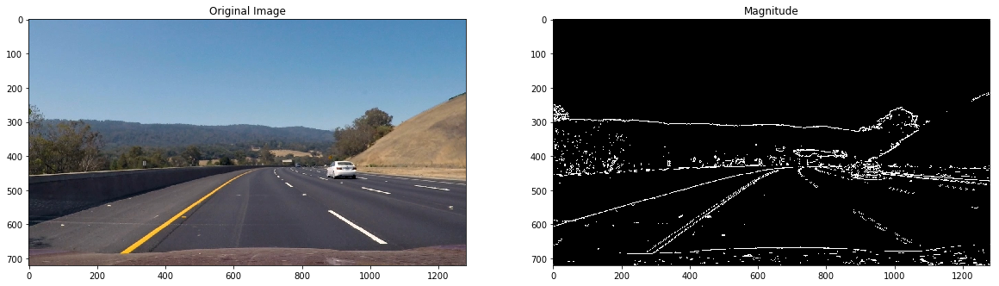

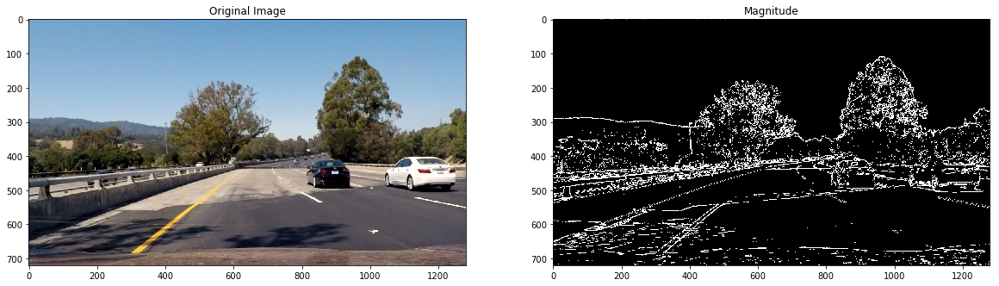

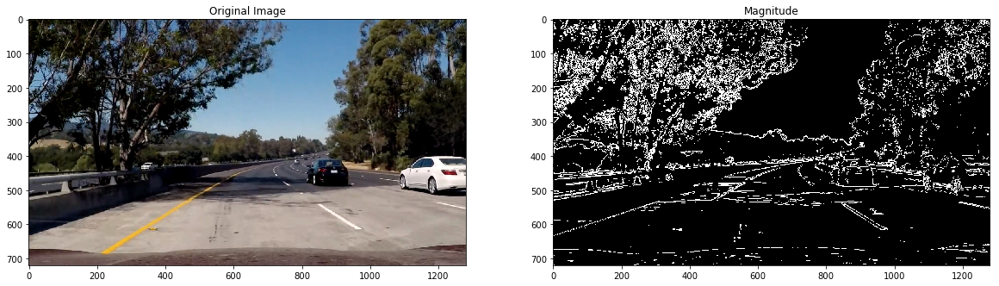

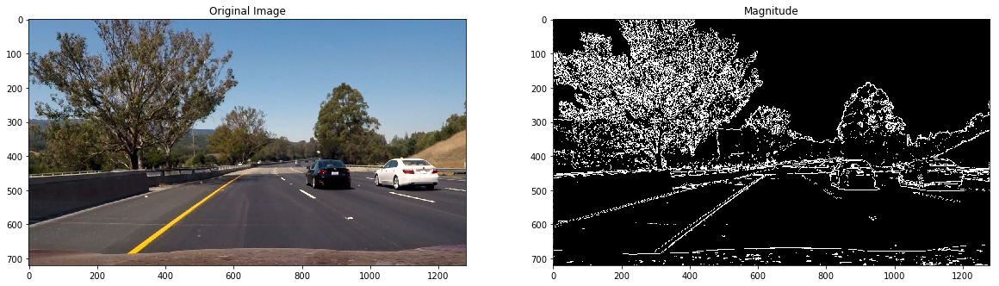

In [12]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate magnitude
    mag = mag_thresh(image, 3, (30,100))
    # plot original and magnitude
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Magnitude')
    ax2.imshow(mag, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_magnitude.png'))
    plt.show()

## Direction of the gradient

In [13]:
# Direction of the gradient
def dir_threshold(img, sobel_kernel=15, thresh=(0.7, 1.3)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = (sobelx ** 2) ** 0.5
    abs_sobely = (sobely ** 2) ** 0.5
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    direction_grad = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    dir_binary = np.zeros_like(direction_grad)
    dir_binary[(direction_grad >= thresh[0]) & (direction_grad <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return dir_binary

## Direction test images

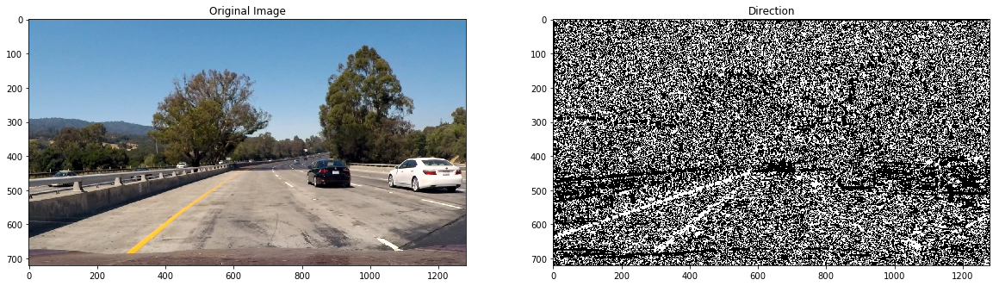

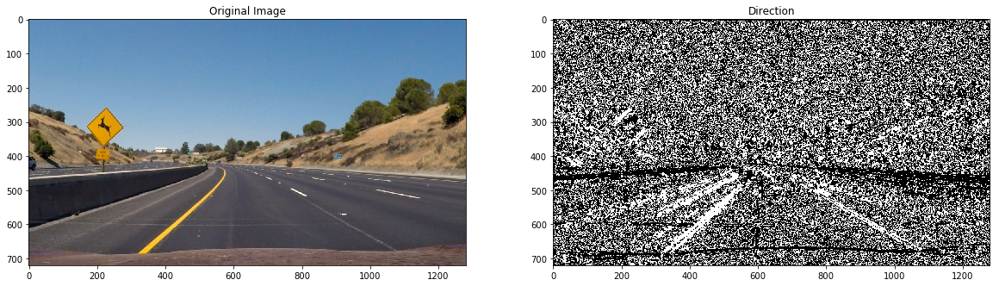

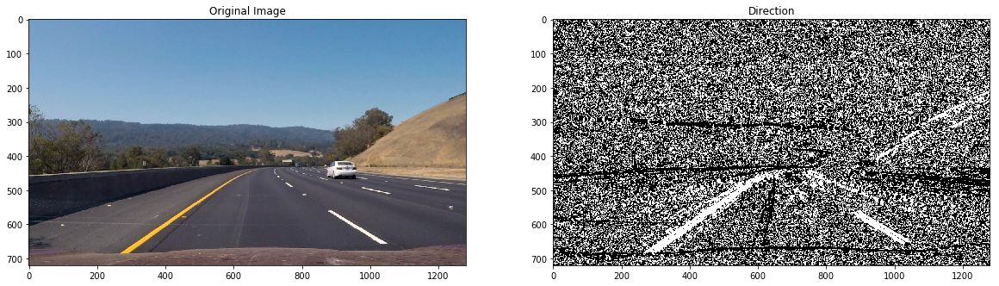

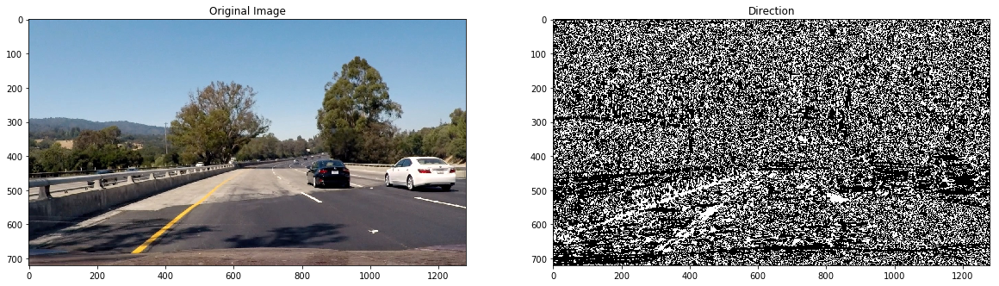

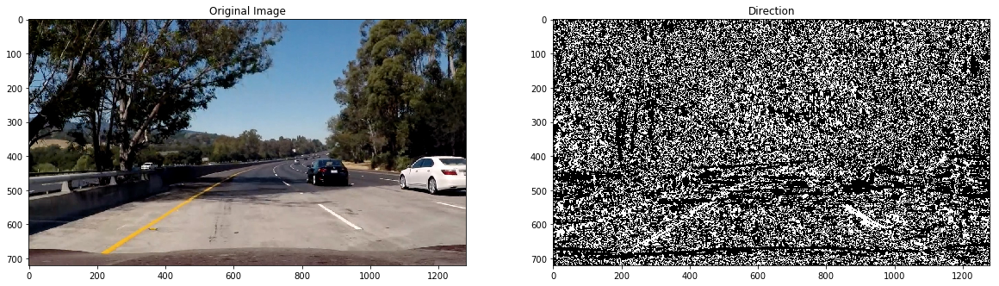

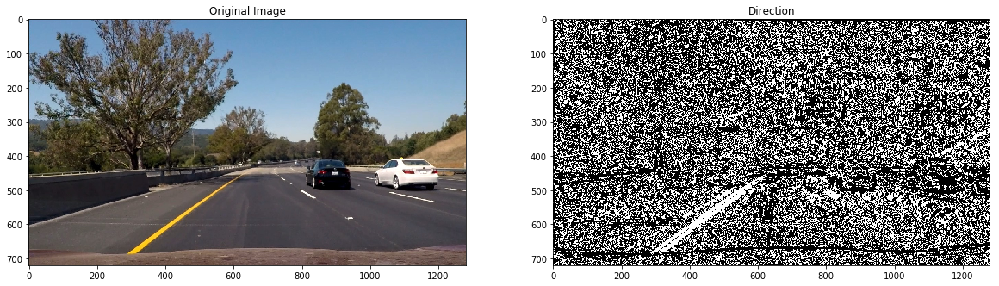

In [14]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate direction
    direction = dir_threshold(image, 15, (0.7, 1.3))
    # plot original and direction
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Direction')
    ax2.imshow(direction, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_direction.png'))
    plt.show()

## Color RGB Thresholds

In [17]:
def color_rgb_threshold(img, rgb_thresh=(180, 255)):
    R = img[:, :, 0]
    G = img[:, :, 1]
    B = img[:, :, 2]

    binaryR = np.zeros_like(R)
    binaryR[(R > rgb_thresh[0]) & (R <= rgb_thresh[1])] = 1

    binaryG = np.zeros_like(G)
    binaryG[(G > rgb_thresh[0]) & (G <= rgb_thresh[1])] = 1

    binaryB = np.zeros_like(B)
    binaryB[(B > rgb_thresh[0]) & (B <= rgb_thresh[1])] = 1

    return binaryR, binaryG, binaryB

### Color RGB test images

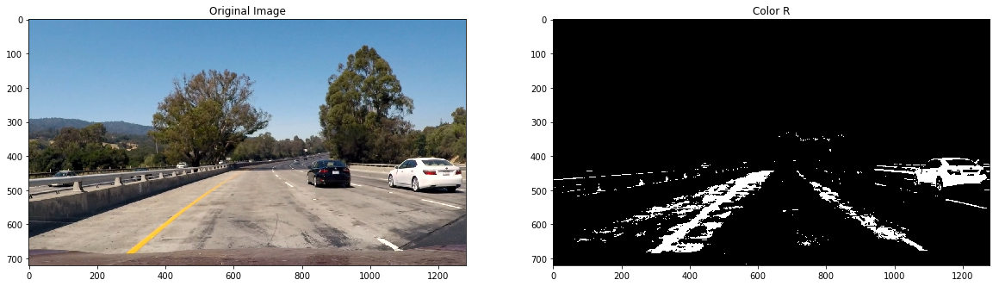

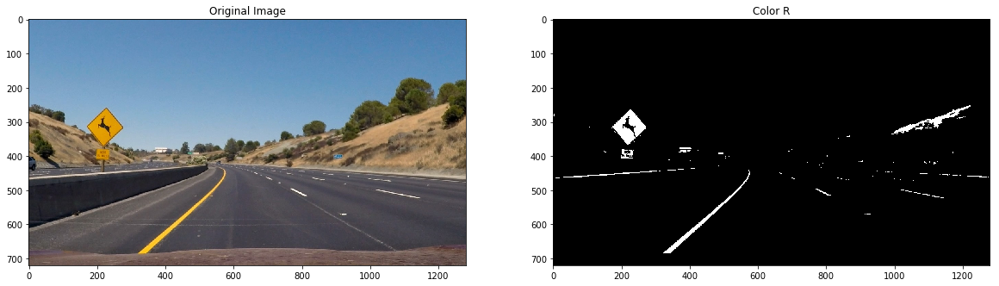

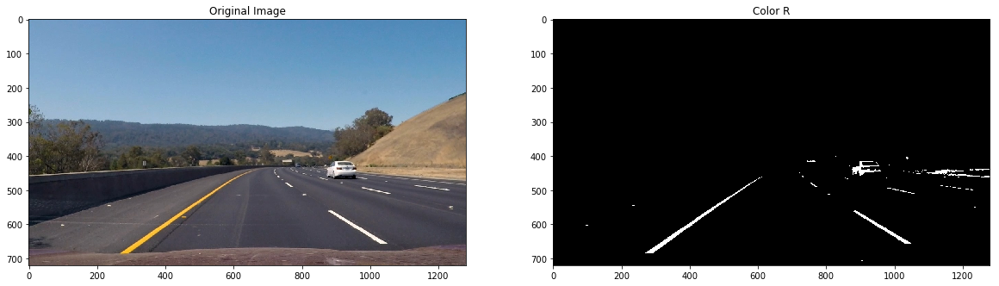

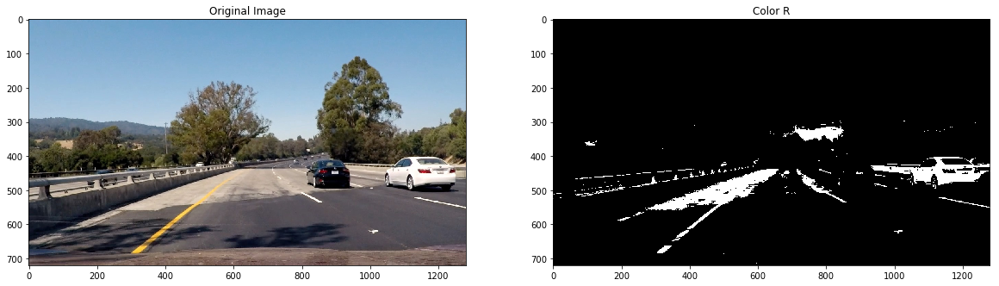

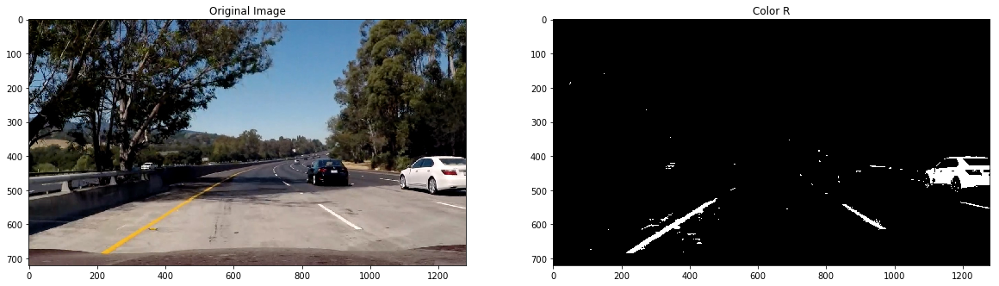

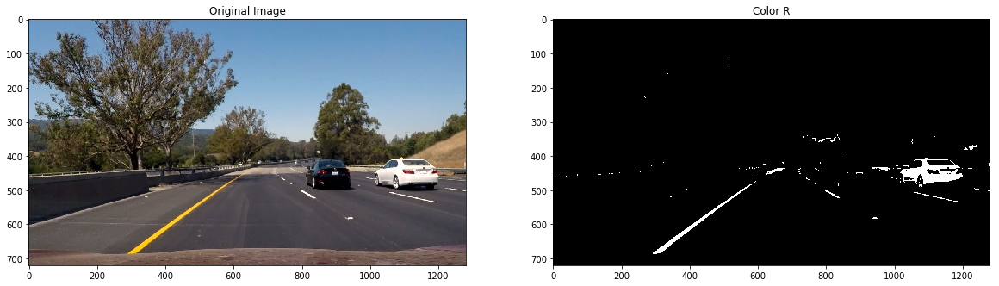

In [18]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate color thresholds
    colorR, colorG, colorB = color_rgb_threshold(image,(200, 255))
    # plot original and color thresholds
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Color R')
    ax2.imshow(colorR, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_color.png'))
    plt.show()

## Color HLS Thresholds

In [19]:
def color_hls_threshold(image, s_thresh=(170, 255), l_thresh=(15, 100), h_thresh=(15, 100)):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:, :, 0]
    L = hls[:, :, 1]
    S = hls[:, :, 2]
    # Threshold color channel

    s_binary = np.zeros_like(S)
    s_binary[(S > s_thresh[0]) & (S <= s_thresh[1])] = 1

    l_binary = np.zeros_like(L)
    l_binary[(L > l_thresh[0]) & (L <= l_thresh[1])] = 1

    h_binary = np.zeros_like(H)
    h_binary[(H > h_thresh[0]) & (H <= h_thresh[1])] = 1

    return s_binary, h_binary, l_binary

### Color HLS test images

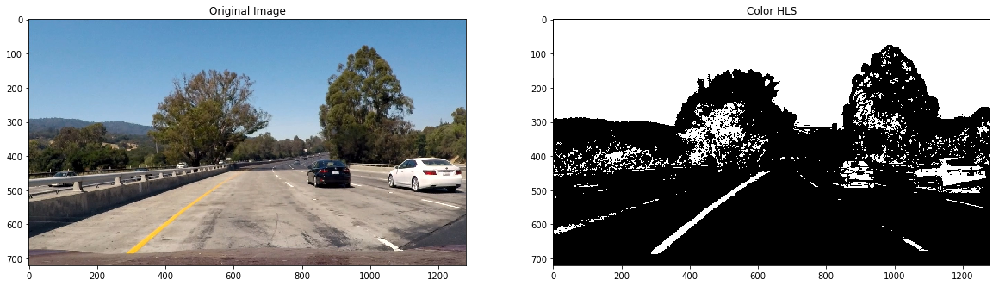

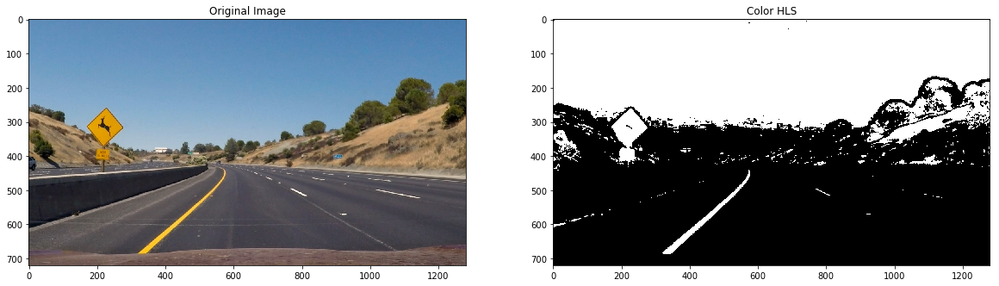

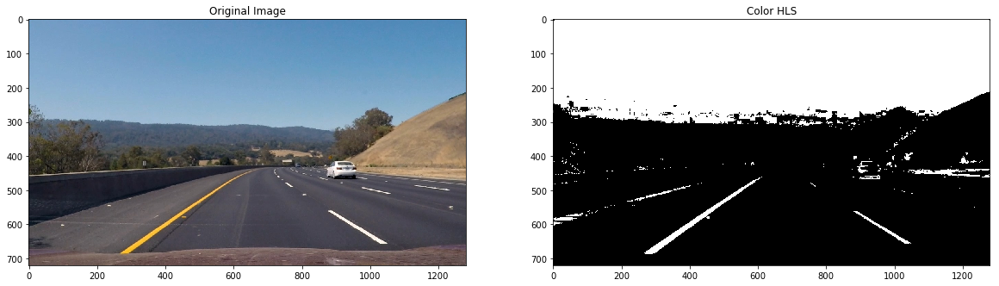

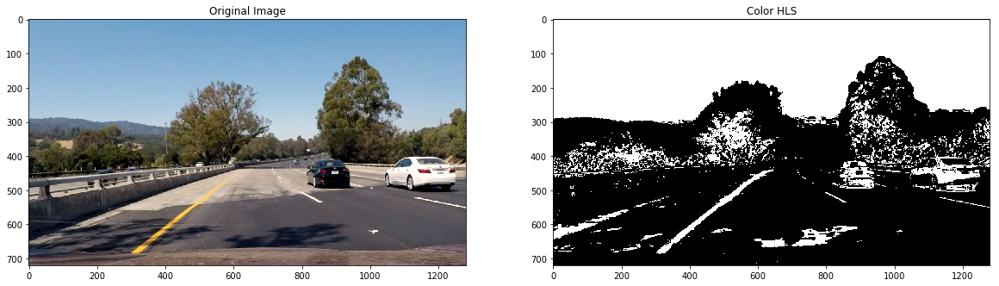

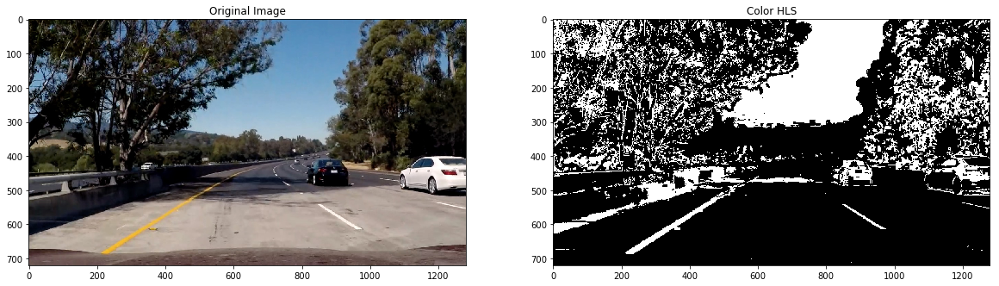

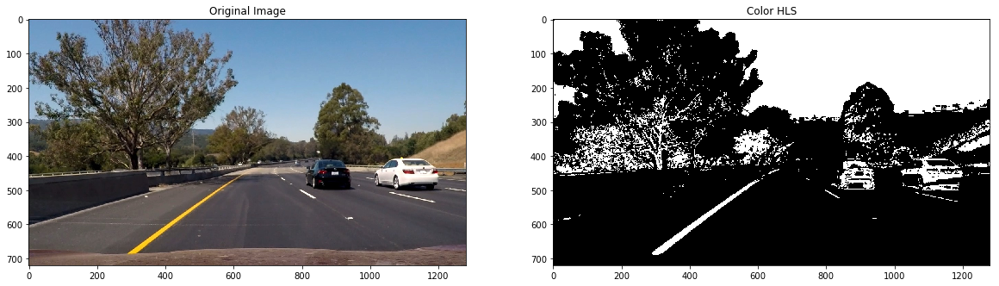

In [20]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate HLS thresholds
    s_threshold, h_threshold, l_threshold = color_hls_threshold(image, (90, 255), (15, 100), (15, 100))
    # plot original and color HLS thresholds
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Color HLS')
    ax2.imshow(s_threshold, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_HLS.png'))
    plt.show()

## Gray Threshold

In [25]:
def gray_threshold(img, gray_thresh=(180, 255)):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    binary = np.zeros_like(gray)
    binary[(gray > gray_thresh[0]) & (gray <= gray_thresh[1])] = 1

    return binary

### Gray test images

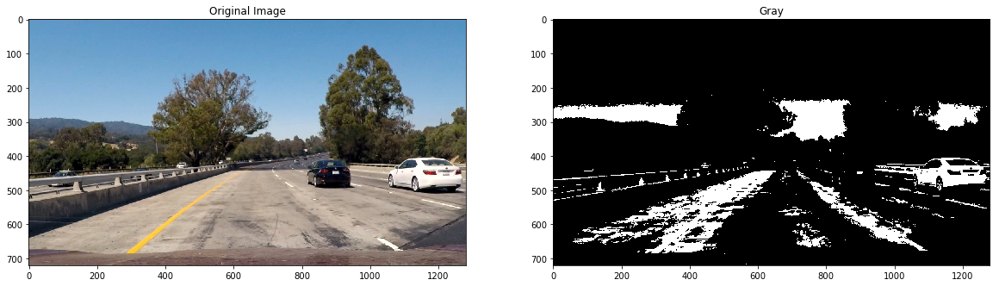

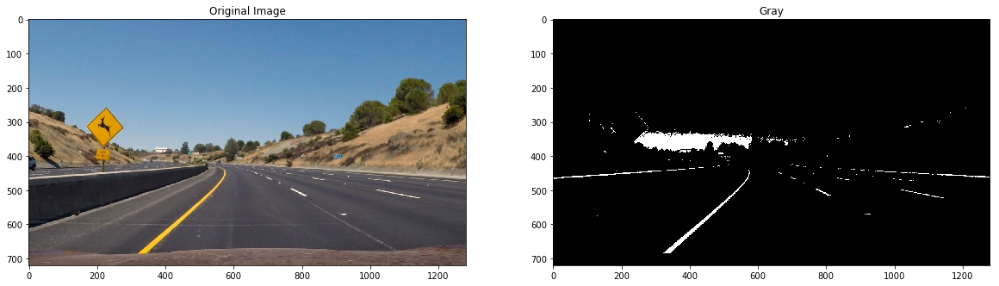

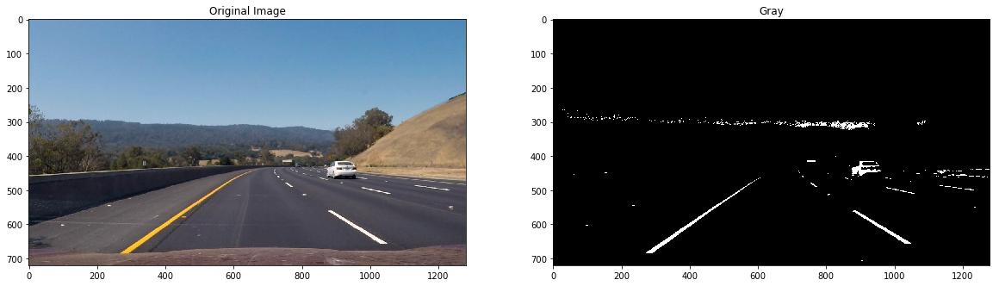

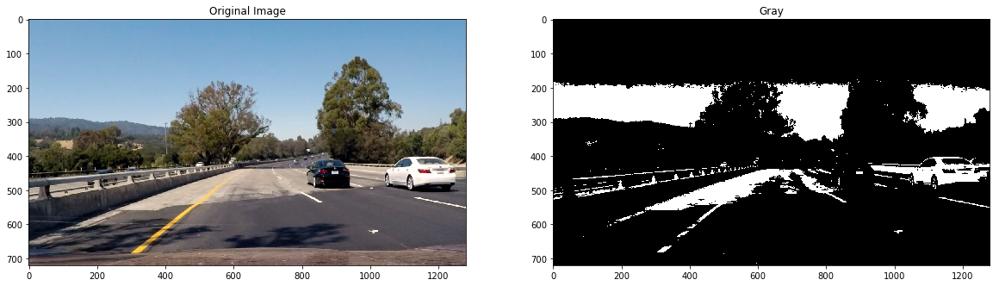

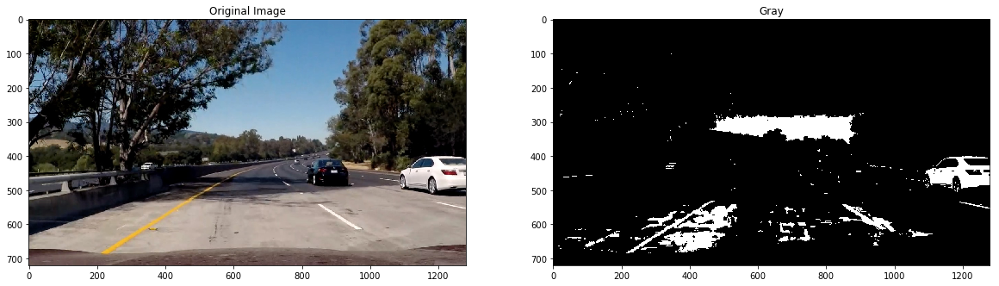

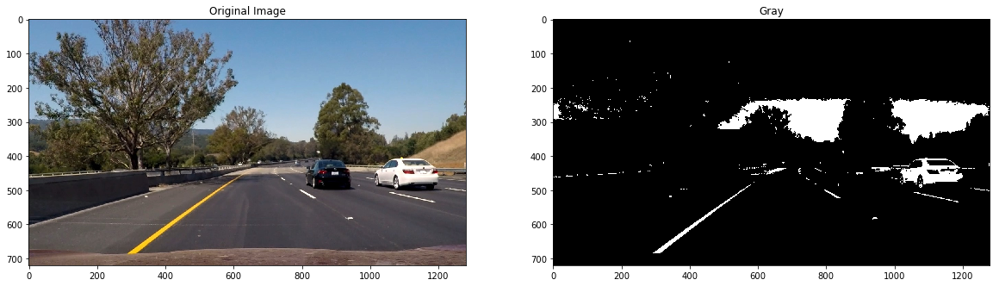

In [26]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # calculate gray thresholds
    gray = gray_threshold(image, (180, 255))
    # plot original and gray threshold
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Gray')
    ax2.imshow(gray, cmap='gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_gray.png'))

## Combined thresholds

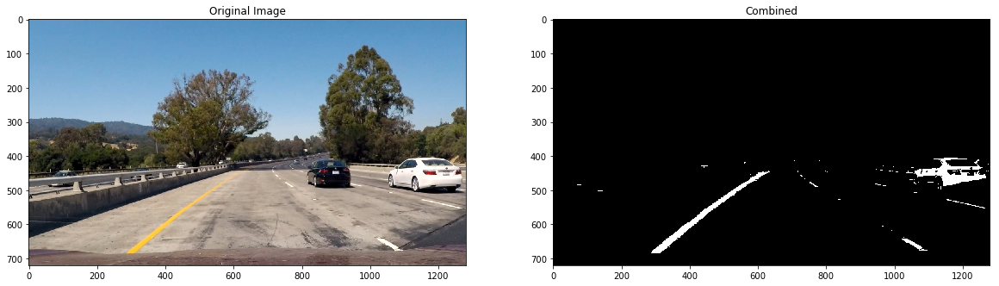

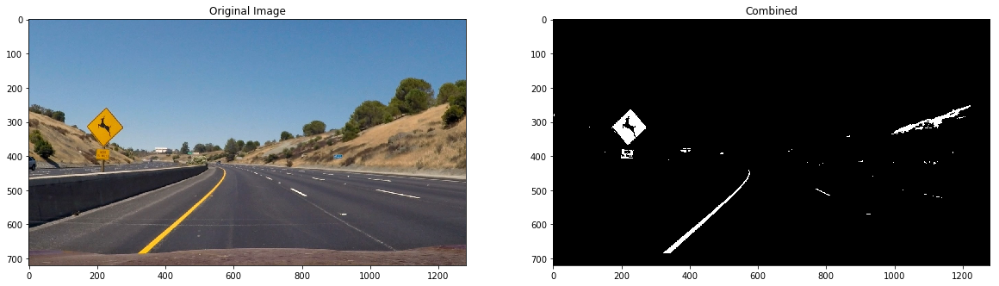

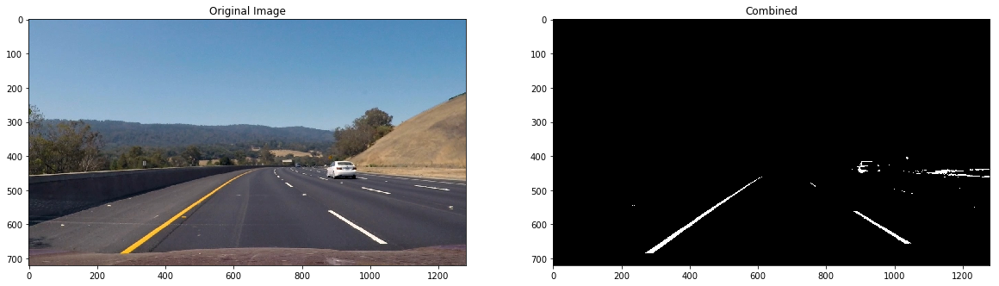

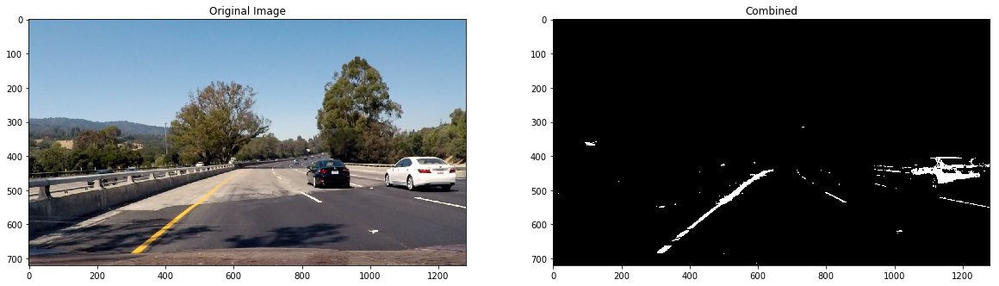

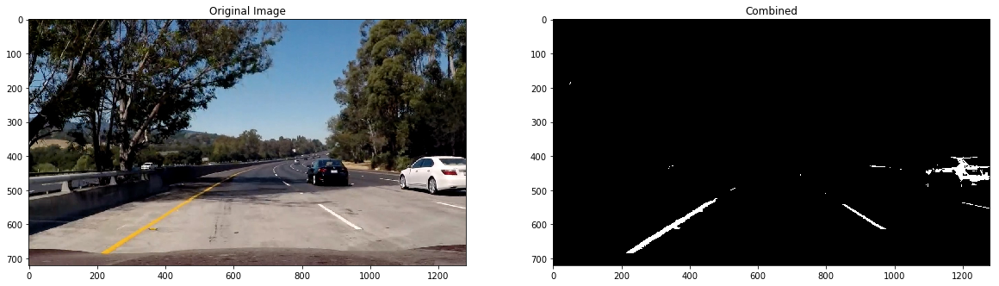

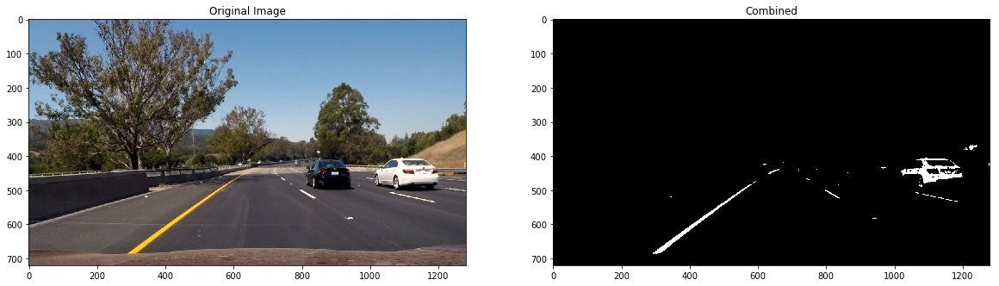

In [27]:
# Apply each of the thresholding functions
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # every filter
    gradx = abs_sobel_thresh(image, 'x', (20, 100))
    grady = abs_sobel_thresh(image, 'y', (20, 100))
    mag_binary = mag_thresh(image, 3, (30, 100))
    dir_binary = dir_threshold(image, 15, (0.7, 1.2))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    
    s_binary, h_binary, l_binary = color_hls_threshold(image, (90, 255), (15, 100), (15, 100))
    colorR, colorG, colorB = color_rgb_threshold(image, (200, 255))
    
    combined_color = np.zeros_like(colorR)
    combined_color[(colorR == 1) & (s_binary == 1)] = 1
    
    # Combined Thresholds
    #combined_binary = np.dstack((np.zeros_like(combined), combined, combined_color))
    
    # plot original and combined
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Combined')
    ax2.imshow(combined_color, cmap = 'gray')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_combined.png'))

## Transformation

In [28]:
def transform(img):
    imgSize = (img.shape[1], img.shape[0])
    
    src = np.float32([[567, 470], [288, 660], [1009, 660], [716, 470]])
    dst = np.float32([[280, 0], [280, 660], [1000, 660], [1000, 0]])
    
    M = cv2.getPerspectiveTransform(src, dst)

    Minv = cv2.getPerspectiveTransform(dst, src)

    warped = cv2.warpPerspective(img, M, imgSize, flags=cv2.INTER_LINEAR)

    return M, Minv, warped

### Example of warped transformation

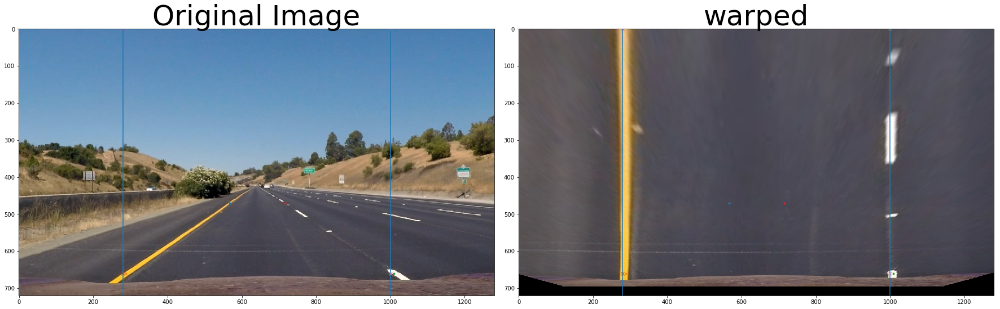

In [31]:
# Read image
imageStraight = os.path.basename('./test_images/straight_lines2.jpg')
imgStraight = mpimg.imread('./test_images/straight_lines1.jpg')

# Transform read image
M, Minv, warped = transform(imgStraight)

# Plot source points into original and destination points into warped image

src = np.float32([[567, 470], [288, 660], [1009, 660], [716, 470]])
dst = np.float32([[280, 0], [280, 660], [1000, 660], [1000, 0]])

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(imgStraight)
ax1.plot(src[0][0], src[0][1], '.')
ax1.plot(src[1][0], src[1][1], '.')
ax1.plot(src[2][0], src[2][1], '.')
ax1.plot(src[3][0], src[3][1], '.')
ax1.axvline(x=dst[0][0])
ax1.axvline(x=dst[2][0])
ax1.plot(dst[0][0], dst[0][1], 'x')
ax1.plot(dst[1][0], dst[1][1], 'x')
ax1.plot(dst[2][0], dst[2][1], 'x')
ax1.plot(dst[3][0], dst[3][1], 'x')

ax1.set_title('Original Image', fontsize=50)
ax2.imshow(warped)
ax2.plot(src[0][0], src[0][1], '.')
ax2.plot(src[1][0], src[1][1], '.')
ax2.plot(src[2][0], src[2][1], '.')
ax2.plot(src[3][0], src[3][1], '.')
ax2.axvline(x=dst[0][0])
ax2.axvline(x=dst[2][0])
ax2.plot(dst[0][0], dst[0][1], 'x')
ax2.plot(dst[1][0], dst[1][1], 'x')
ax2.plot(dst[2][0], dst[2][1], 'x')
ax2.plot(dst[3][0], dst[3][1], 'x')

ax2.set_title('warped', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('{}'.format('./output_images/straightLinesWarped.png'))
plt.show()


# Find lane pixels and fit polynomial

## Find lane pixels

In [32]:
def find_lane_pixels(img):
    
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)

    # Create an output image to draw on and visualize the result
    out_img = np.dstack((img, img, img)) * 255

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0] // 2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(img.shape[0] // nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    left_lane_center = []
    right_lane_center = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window + 1) * window_height
        win_y_high = img.shape[0] - window * window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin  
        win_xright_low = rightx_current - margin 
        win_xright_high = rightx_current + margin  

        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low, win_y_low),
                      (win_xleft_high, win_y_high), (0, 255, 0), 2)
        cv2.rectangle(out_img, (win_xright_low, win_y_low),
                      (win_xright_high, win_y_high), (0, 255, 0), 2)

        ### Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]

        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)

        ### If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            left_lane_center.append(leftx_current) 
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            right_lane_center.append(rightx_current)

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
        
        
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
   
    y = np.linspace(0, out_img.shape[0]-1, out_img.shape[0])
    x = left_fit[0]*y**2 + left_fit[1]*y + left_fit[2]
    pts = np.array([np.transpose(np.vstack([x, y]))])
    cv2.polylines(out_img, np.int_(pts), isClosed=False, color=(255, 255,0), thickness=5)
    
    
    y = np.linspace(0, out_img.shape[0]-1, out_img.shape[0])
    x = right_fit[0]*y**2 + right_fit[1]*y + right_fit[2]
    pts = np.array([np.transpose(np.vstack([x, y]))])
    cv2.polylines(out_img, np.int_(pts), isClosed=False, color=(255, 255,0), thickness=5)
    

    return  left_fitx, right_fitx, out_img, ploty, left_lane_center, right_lane_center, leftx, lefty, rightx, righty


## Find lane pixels test images

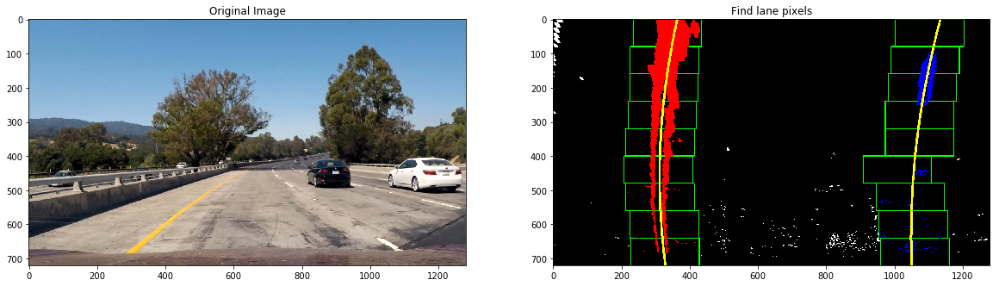

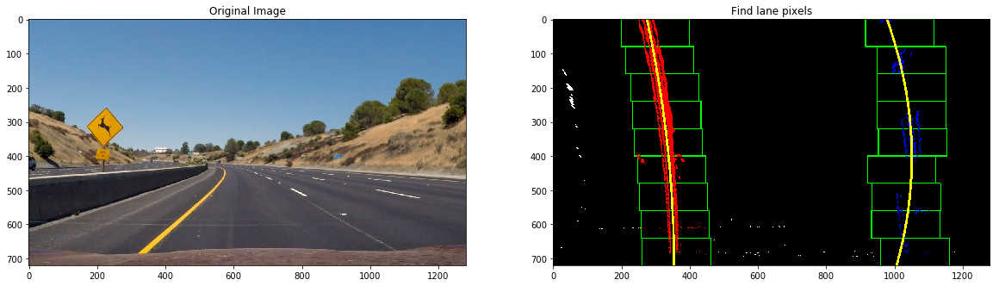

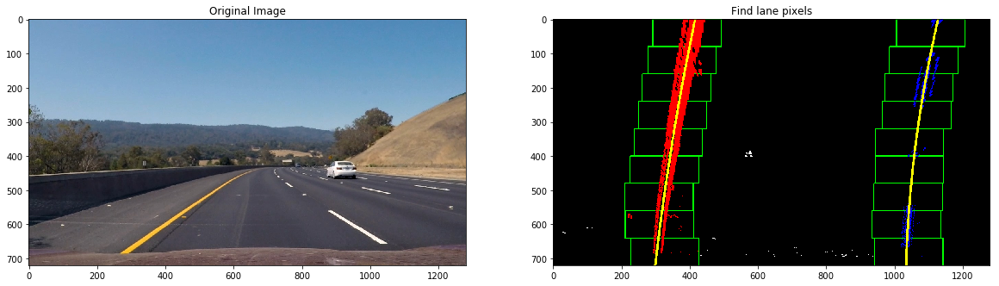

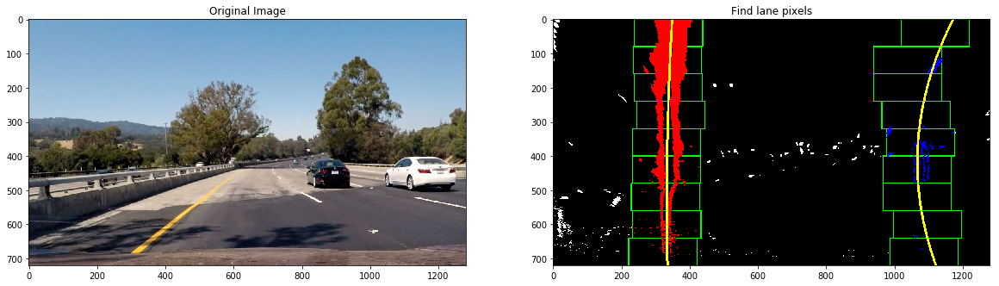

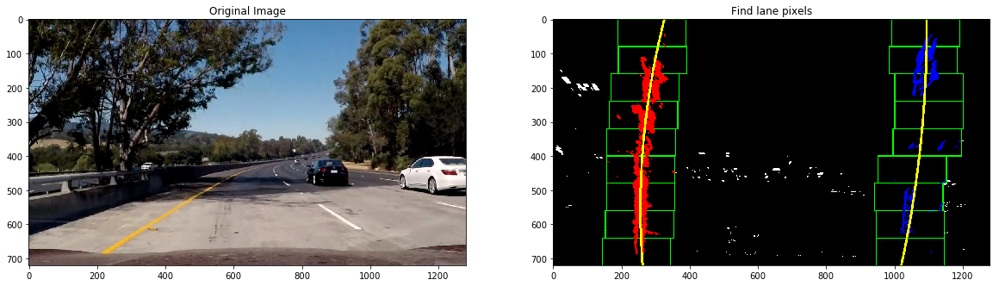

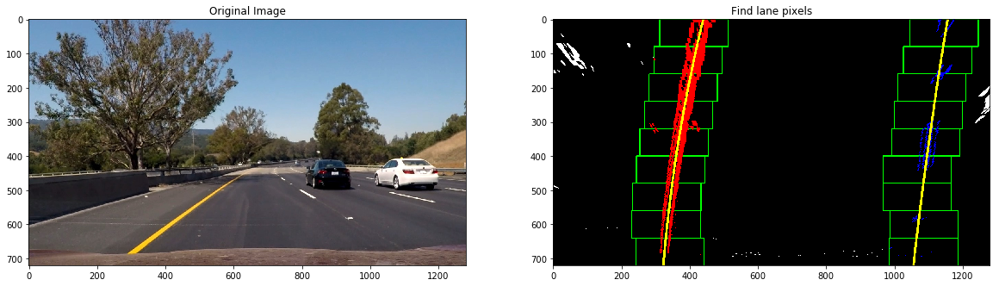

In [26]:
images = glob.glob('./test_images/test*.jpg')

i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    undist = undistorting(image, objpoints, imgpoints)
    
    gradx = abs_sobel_thresh(undist, 'x', (20, 100))
    grady = abs_sobel_thresh(undist, 'y', (20, 100))
    mag_binary = mag_thresh(undist, 3, (30, 100))
    dir_binary = dir_threshold(undist, 15, (0.7, 1.3))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    
    s_binary, h_binary, l_binary = color_hls_threshold(undist, (90, 200), (15, 100), (15, 100))
    colorR, colorG, colorB = color_rgb_threshold(undist, (200, 255))
    
    combined_color = np.zeros_like(colorR)
    combined_color[(colorR == 1) & (s_binary == 1)] = 1
    
    combined_binary = np.zeros_like(combined_color)
    combined_binary[(combined == 1)| (combined_color == 1)] = 1
    
    M, Minv, combined_color = transform(combined_binary)
    
    
    left_fitx, right_fitx, out_img, ploty, left_lane_center, right_lane_center, leftx, lefty, rightx, righty = find_lane_pixels(combined_color)
    
    # plot original and Find lane pixels
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Find lane pixels')
    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_findLanePx.png'))

# Histogram

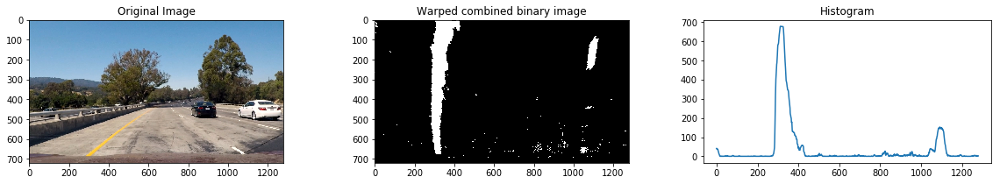

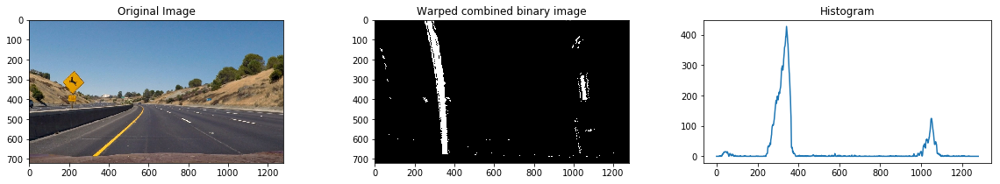

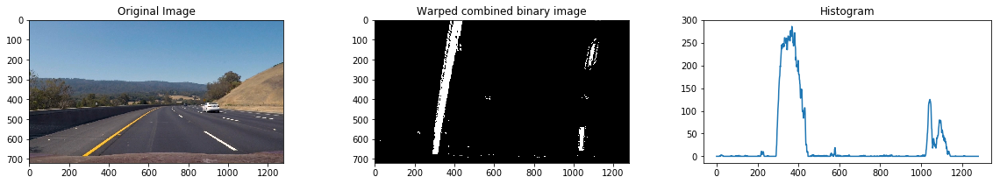

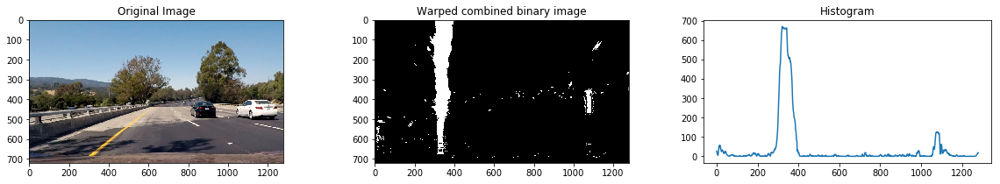

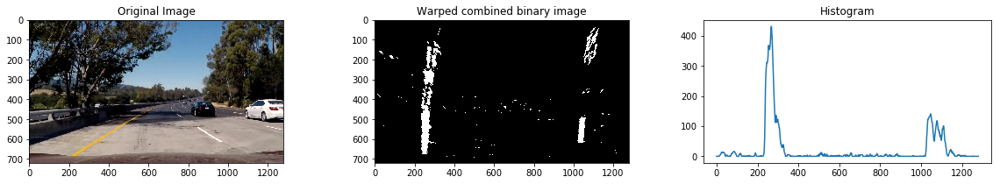

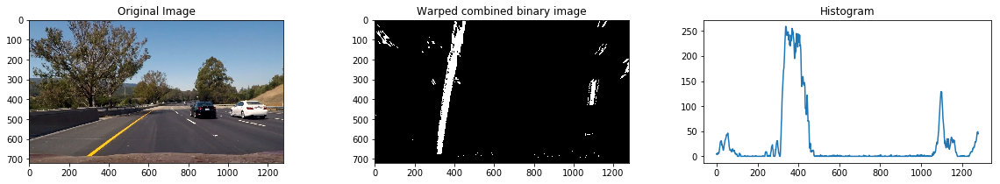

In [33]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    # every filter
    gradx = abs_sobel_thresh(image, 'x',(20, 100))
    grady = abs_sobel_thresh(image, 'y', (20, 100))
    mag_binary = mag_thresh(image, 3, (30, 100))
    dir_binary = dir_threshold(image, 15, (0.7, 1.2))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    
    s_binary, h_binary, l_binary = color_hls_threshold(image, (90, 255), (15, 100), (15, 100))
    colorR, colorG, colorB = color_rgb_threshold(image, (200, 255))
    
    combined_color = np.zeros_like(colorR)
    combined_color[(colorR == 1) & (s_binary == 1)] = 1
    
    # Combined Thresholds
    combined_binary = np.zeros_like(combined_color)
    combined_binary[(combined == 1)| (combined_color == 1)] = 1
    
    # calculate warped
    M, Minv, warped = transform(combined_binary)
    
    
    histogram = np.sum(warped, axis=0)
    
    # plot original and gray threshold
    f, (ax1, ax2, ax3) = plt.subplots(1,3,figsize=(20,3))
    ax1.set_title('Original Image')
    ax1.imshow(image)
    ax2.set_title('Warped combined binary image')
    ax2.imshow(warped, cmap='gray')
    ax3.set_title('Histogram')
    ax3.plot(histogram)
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_warpedBinaryCombinedHistogram.png'))

# Distance from the center

In [34]:
def distanceFromCent(image, left_center, right_center):
    width = image.shape[1]
    cameraCenter = width/2
    left_lane_location = left_center[0]
    right_lane_location = right_center[0]
    lane_center = (right_lane_location - left_lane_location)/2 + left_lane_location
    # calculate off center in meter
    offCenter = abs(lane_center - cameraCenter) * (3.7/700)
    return offCenter    

# Find radius

In [35]:
def radius(ploty, leftx, rightx, lefty, righty):
    yMeterPerPixel = 30. / 720
    xMeterPerPixel = 3.7 / 700

    leftFitMeter = np.polyfit(lefty * yMeterPerPixel, leftx * xMeterPerPixel, 2)
    rightFitMeter = np.polyfit(righty * yMeterPerPixel, rightx * xMeterPerPixel, 2)

    left_curverad = ((1 + (2 * leftFitMeter[0] * 30 + leftFitMeter[1]) ** 2) ** 1.5) / np.absolute(2 * leftFitMeter[0])
    right_curverad = ((1 + (2 * rightFitMeter[0] * 30 + rightFitMeter[1]) ** 2) ** 1.5) / np.absolute(2 * rightFitMeter[0])

    left_lane = leftFitMeter[0] * (720 * yMeterPerPixel) ** 2 + leftFitMeter[1] * 720 * yMeterPerPixel + leftFitMeter[2]
    right_lane = rightFitMeter[0] * (720 * yMeterPerPixel) ** 2 + rightFitMeter[1] * 720 * yMeterPerPixel + rightFitMeter[2]

    radm = np.mean([left_curverad, right_curverad])
    return radm

# Final Draw of rectified image warped back onto the original image

In [36]:
def finalDraw(original_img, img, left_fitx, right_fitx, Minv, ploty, radius, offset):
    warp_zero = np.zeros_like(img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    #ploty = np.linspace(0, img.shape[0] - 1, img.shape[0])
    #leftx = left_fitx[0] * ploty ** 2 + left_fitx[1] * ploty + left_fitx[2]
    #rightx = right_fitx[0] * ploty ** 2 + right_fitx[1] * ploty + right_fitx[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0]))
    
    # Combine the result with the original image
    result = cv2.addWeighted(original_img, 1, newwarp, 0.3, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX
    result = cv2.putText(result, 'Radius of Curvature: {} m'.format(radius), (50, 100), font, 1, (255, 255, 255), 4)
    result = cv2.putText(result, 'Offset: {} m'.format(offset), (50, 200), font, 1, (255, 255, 255), 4)
    return result   

# Pipeline for test images

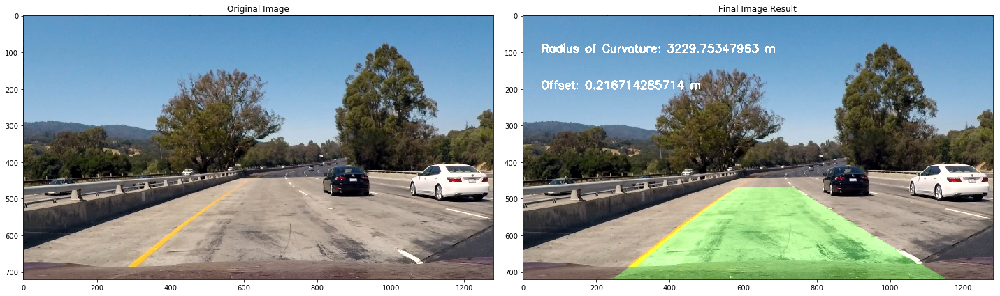

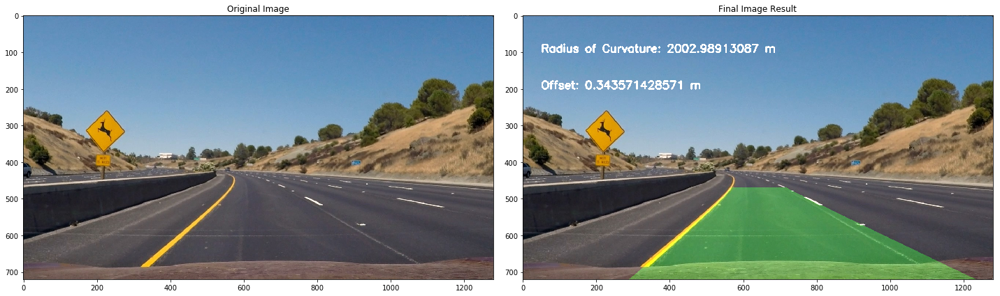

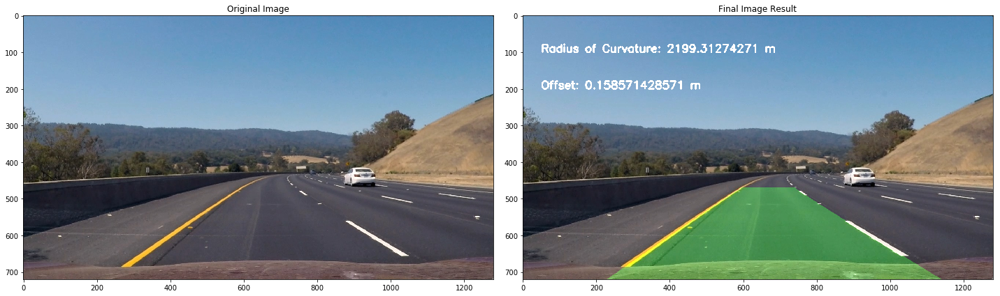

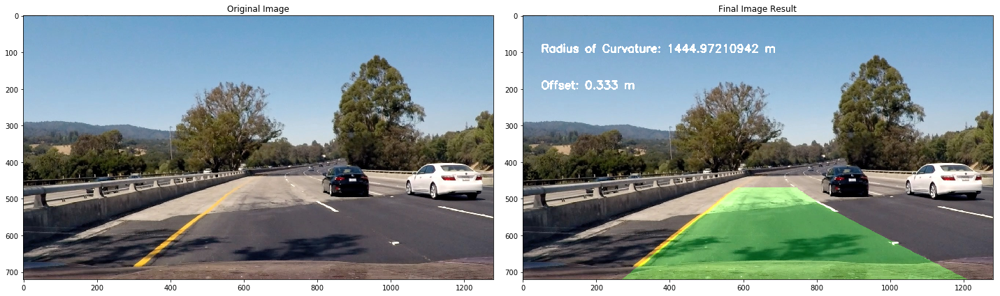

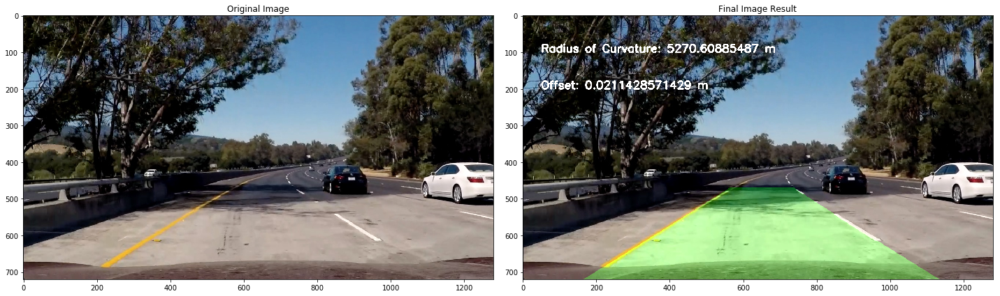

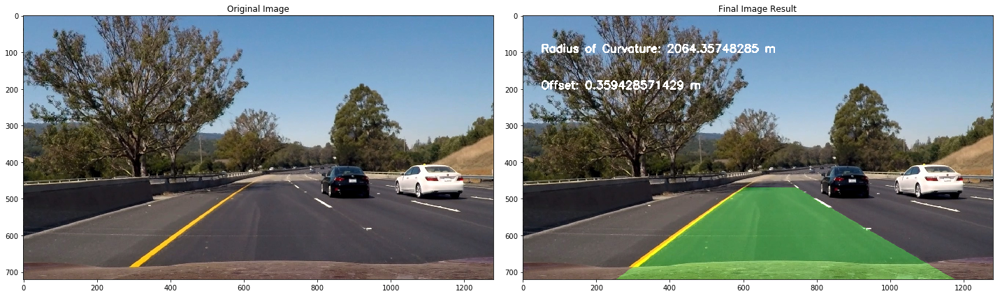

In [37]:
images = glob.glob('./test_images/test*.jpg')
i=0
for fname in images:
    i=i+1
    # read each image
    image = mpimg.imread(fname)
    undist = undistorting(image, objpoints, imgpoints)
    
    gradx = abs_sobel_thresh(undist, 'x', (20, 100))
    grady = abs_sobel_thresh(undist, 'y', (20, 100))
    mag_binary = mag_thresh(undist, 3, (30, 100))
    dir_binary = dir_threshold(undist, 15, (0.7, 1.3))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    
    s_binary, h_binary, l_binary = color_hls_threshold(undist, (170, 255), (15, 100), (15, 100))
    colorR, colorG, colorB = color_rgb_threshold(undist, (220, 255))
    
    combined_color = np.zeros_like(colorR)
    combined_color[(colorR == 1) & (s_binary == 1)] = 1
    
    combined_binary = np.zeros_like(combined_color)
    combined_binary[(combined_color == 1) | (combined == 1)] = 1
    
    M, Minv, warped = transform(combined_color)
        

    left_fitx, right_fitx, out_img, ploty, left_lane_center, right_lane_center, leftx, lefty, rightx, righty = find_lane_pixels(warped)
    
    Offset = distanceFromCent(combined_color, left_lane_center, right_lane_center)
    rad = radius(ploty, leftx, rightx, lefty, righty)
    
    
    final = finalDraw(image, warped, left_fitx, right_fitx, Minv, ploty, rad, Offset)
    
    
    
    # plot original and gray threshold
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(20,10))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image')
    ax2.imshow(final)
    ax2.set_title('Final Image Result')
    
    plt.savefig('{}/{}'.format('./output_images/', 'Test_' + str(i) + '_FinalResult.png'))
    


# Test on videos

In [38]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [39]:
def process_image(image):
    undist = undistorting(image, objpoints, imgpoints)
    
    gradx = abs_sobel_thresh(undist, 'x', (20, 100))
    grady = abs_sobel_thresh(undist, 'y', (20, 100))
    mag_binary = mag_thresh(undist, 3, (30, 100))
    dir_binary = dir_threshold(undist, 15, (0.7, 1.3))
    
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    
    
    s_binary, h_binary, l_binary = color_hls_threshold(undist, (170, 255), (15, 100), (15, 100))
    colorR, colorG, colorB = color_rgb_threshold(undist, (220, 255))
    
    combined_color = np.zeros_like(colorR)
    combined_color[(colorR == 1) & (s_binary == 1)] = 1
    
    combined_binary = np.zeros_like(combined_color)
    combined_binary[(combined_color == 1) | (combined == 1)] = 1
    
    M, Minv, warped = transform(combined_binary)
        

    left_fitx, right_fitx, out_img, ploty, left_lane_center, right_lane_center, leftx, lefty, rightx, righty = find_lane_pixels(warped)
    
    Offset = distanceFromCent(combined_color, left_lane_center, right_lane_center)
    rad = radius(ploty, leftx, rightx, lefty, righty)
    
    
    final = finalDraw(image, warped, left_fitx, right_fitx, Minv, ploty, rad, Offset)
    return final
    
    
    
    

In [40]:
from moviepy.video.io.ffmpeg_tools import ffmpeg_extract_subclip
vid_output = './test_videos_output/test_project_video_out.mp4'
clip = VideoFileClip('project_video.mp4')
vid_clip = clip.fl_image(process_image)
%time vid_clip.write_videofile(vid_output, audio=False)

Moviepy - Building video ./test_videos_output/test_project_video_out.mp4.
Moviepy - Writing video ./test_videos_output/test_project_video_out.mp4



Moviepy - Done !
Moviepy - video ready ./test_videos_output/test_project_video_out.mp4
Wall time: 19min 2s
